# Building a supervised machine learning model along with resmapling method to tackle credit card fraud

# 1. Import the essential libraries and dataset


In [1]:
# import basic libraries
import numpy as np
import pandas as pd

# import plot libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# dataset split for train and test set
from sklearn.model_selection import train_test_split

# features normalization using standard scaler
from sklearn.preprocessing import StandardScaler

# Autoencoder 的部分可以去掉不要，因为太多内容了
# Autoencoder and UMAP data visualization
# Keras NN related libraries
from keras import layers
from keras.layers import Input, Dense
from keras.models import Model
from keras import regularizers
from umap import UMAP

# import imblearn library for resampling
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE

# model related libraries
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, StratifiedKFold, cross_val_score
from imblearn import FunctionSampler
from imblearn.pipeline import Pipeline

# Assessment metrics
from sklearn.metrics import (
    average_precision_score,
    PrecisionRecallDisplay,
    confusion_matrix,
    classification_report
)

# several config
%config InlineBackend.figure_format = 'png'
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [2]:
# read target dataset into pandas dataframe
df = pd.read_csv('project/dataset/creditcard.csv')

# 2 Dataset exploration

## 2.1 Statistical analysis of data characteristics

In [3]:
# get a glance of the dataset
df.head(4)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0


In [4]:
df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.168375e-15,3.416908e-16,-1.379537e-15,2.074095e-15,9.604066e-16,1.487313e-15,-5.556467e-16,1.213481e-16,-2.406331e-15,...,1.654067e-16,-3.568593e-16,2.578648e-16,4.473266e-15,5.340915e-16,1.683437e-15,-3.660091e-16,-1.227390e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

### Check the percentage of fraud and non-fraud transaction

In [6]:
# define a unction that shows percentage of fraud and normal transactions
def perc(dataset):
    perc = round(dataset.Class.value_counts() / len(dataset) * 100, ndigits=3)
    perc_np = perc.to_numpy()
    
    print('The percentage of transactions:')
    print(f' Fraud:  {perc_np[1]}%')
    print(f'Normal: {perc_np[0]}%')
    print()
    print(f'The dataset have {dataset.Class.value_counts()[1]} fraud transactions.')
    print(f'The dataset have {dataset.Class.value_counts()[0]} normal transactions.')

perc(df)

The percentage:
 Fraud: 0.173%
Normal: 99.827%

The fraud transactions account for 492.
The normal transactions account for 284315.


### pie chart for percentage visualization

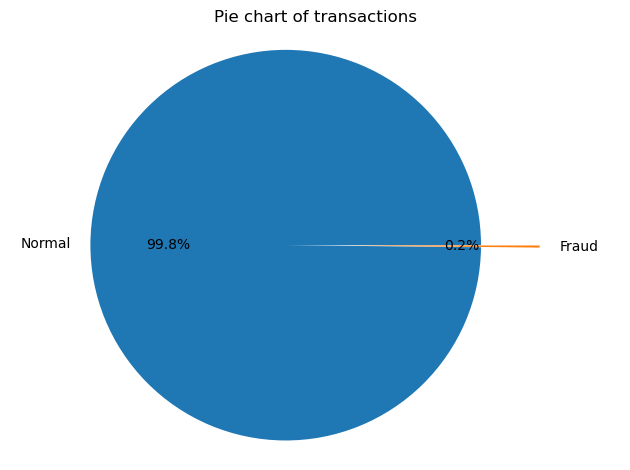

In [7]:
counts = df.copy().Class.value_counts()
lab = ['Normal', 'Fraud']
exp = [0.1, 0.2]

plt.pie(counts, labels=lab, explode=exp, autopct='%1.1f%%')

plt.title('Pie chart of transactions percentage')
plt.tight_layout()
plt.axis('equal')

plt.show()

## 2.2 Data visualization analysis
In this session, few pictures will be generated to present the dataset. The relations between features in this dataset will be presented. Several techniques used in data visualization will be listed below,
1. Correlation analysis
    1. **correlation coefficient** matrix
    2. **scatter plot** (using pairplot from Seaborn)
2. Autoencoder features extraction
    1. use autoencoder to extract original 28 features into 2 or 4 features(hidden layer)
    2. use UMAP to visualize the hidden layer

is some examples to get insights by using data visualization.  
Several plots will be shown in this session, such as scatter, histogram, etc.

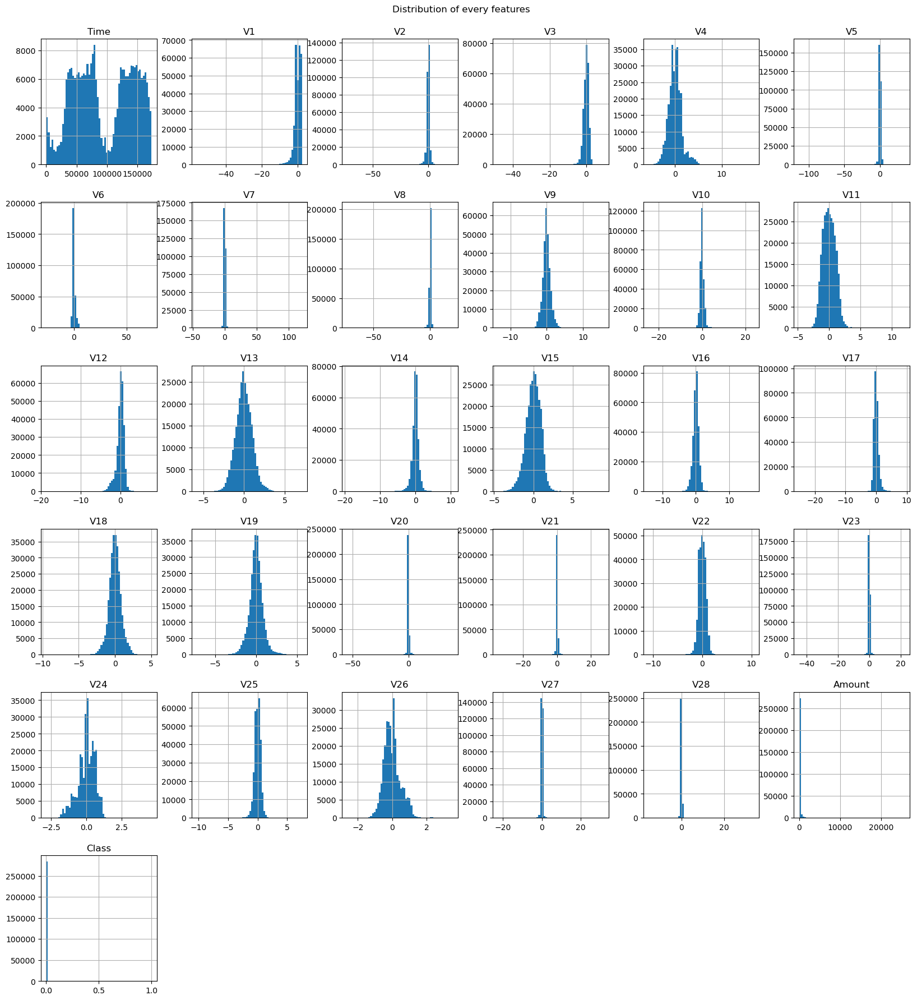

In [8]:
# distribution of each feature by using histogram
hist = df.hist(bins=60, figsize=(20, 20))

plt.subplots_adjust(top=.95)
plt.suptitle('Distribution of each feature')

plt.show()

### 2.2.1 Correlation analysis

1. Dropping time and amount columns since they are not correlated with fraud behavior
2. Other columns could be dropped futher
3. Make each of them separated dataframe
4. inspect the result of each dataframe



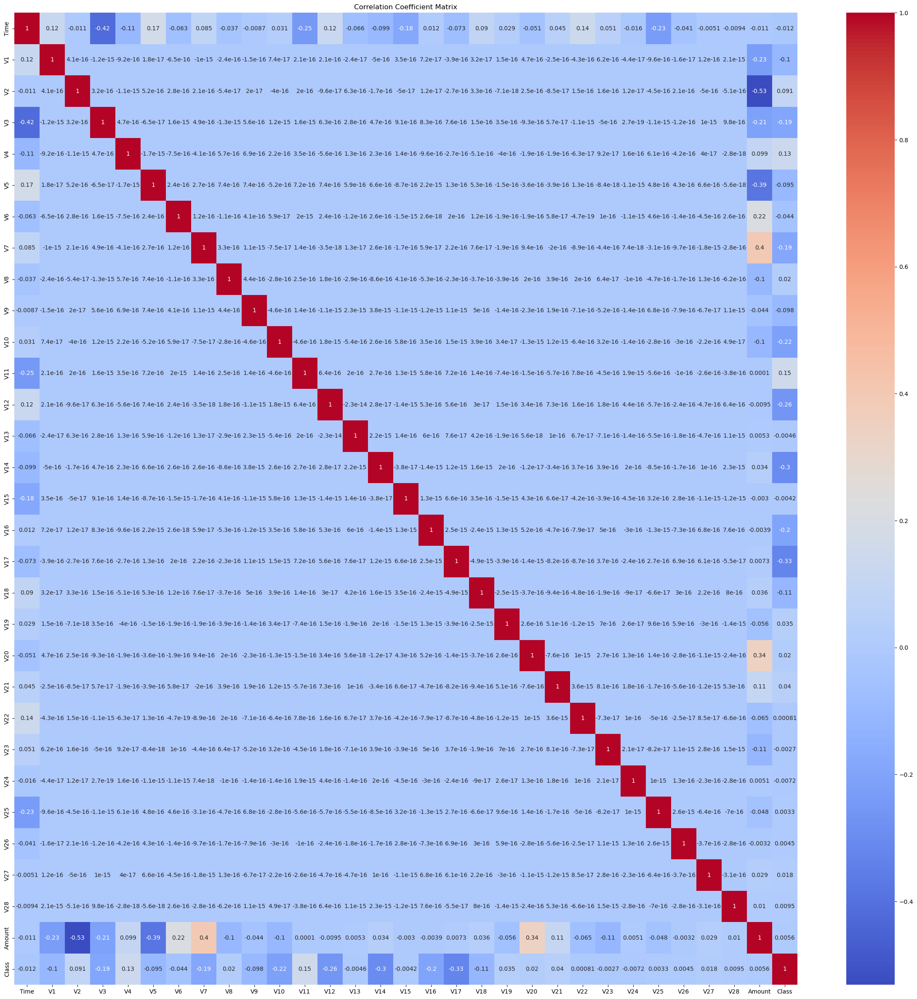

In [12]:
# compute the correlation matrix between features
correlation_matrix = df.corr()

# set the figure size
plt.figure(figsize=(30, 30))

# plot the correlation matrix as a heatmap
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')

# Add title and adjust the layout
plt.subplots_adjust(top=.95)
plt.title('Correlation Coefficient Matrix')
plt.tight_layout()

# Display the plot
plt.show()

### Feature selection based on correlation coefficient

In [13]:
# define a function to calculate correlation between nemerical features and the Class feature
# set threshold to 0.12 and select the features which have higher socore than threshold
def corr_list(dataset):
    
    # correlations between nemerical features and the Class feature
    corr = dataset.corr()['Class'].to_dict()
    output_dict = {}
    
    for key, value in corr.items():
        if abs(value) > 0.12:
            output_dict[key] = round(value, 3)
    
    return output_dict

In [14]:
fea_corr = corr_list(df)
fea_corr

{'V3': -0.19296,
 'V4': 0.13345,
 'V7': -0.18726,
 'V10': -0.21688,
 'V11': 0.15488,
 'V12': -0.26059,
 'V14': -0.30254,
 'V16': -0.19654,
 'V17': -0.32648,
 'Class': 1.0}

### Dataset transformation

In [3]:
# define a function for feature selection
def keep_col(dataset, columns=None):
    
    df_keep = dataset.copy()
    
    if columns is not None:
        df_keep = df_keep[columns]

    return df_keep

In [4]:
# make new datasets forfuther data visualization, data split, and data manipulation
# df_obvious_feats is used for comparison of 'Time' and 'Amount'
# df_hidden_feats is used for comparison of all numerical features
df_obvious_feats = keep_col(df, columns=['Time', 'Amount', 'Class'])
df_hidden_feats = keep_col(df.drop(['Time', 'Amount'], axis=1))

# save dataset for further testing
df_hidden_feats.to_csv('project/981B/df_origin.csv', index=False)

In [5]:
df_hidden_feats.head(4)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,...,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,0
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,...,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,0
2,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,...,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,0
3,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,...,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,0


In [6]:
df_hidden_feats.Class.value_counts()

0    284315
1       492
Name: Class, dtype: int64

### 2.2.2 Data visualization after correlation analysis
In this section, related features from dataset will be presented in the Seaborn pair plot.

Based on the correlation coefficient matrix, the features will be split into 3 groups,
1. Time and Amount columns
2. Features of high correlation
3. Features of low correlation

In [95]:
# plot relationship between each selected features
# dataset is a dataframe, and features is a list of column name(str)
def pair_sca(dataset, features=None):
    
    # sort the dataset in case to plot fraud transactions last.
    # switch 'Class' value from 0 and 1 to 'Normal' and 'Fraud' respectively
    trans_dataset = dataset.sort_values('Class').replace({'Class': {0: 'normal', 1: 'fraud'}})
    
    g = sns.pairplot(data=trans_dataset, vars=features, hue='Class',
                     plot_kws={'alpha':0.5}, corner=True).fig

    g.suptitle("Relationship between numerical features.")
    g.subplots_adjust(top=.95)
    plt.show()

# plot relationship between two specific features
# dataset is a pandas dataframe, and col_1, col_2 are the specific column name(str)
def single_sca(dataset, col_1, col_2):
    
    # sort the dataset in case to plot fraud transactions last.
    # switch 'Class' value from 0 and 1 to 'Normal' and 'Fraud' respectively
    trans_dataset = dataset.sort_values('Class').replace({'Class': {0: 'Normal', 1: 'Fraud'}})
    
    g = sns.jointplot(data=trans_dataset, x=col_1, y=col_2, hue='Class',
                      joint_kws={'alpha':0.6}, height=5).fig
    
    g.suptitle(f"Relationship between {col_1} and {col_2}.")
    g.subplots_adjust(top=.9)
    plt.show()

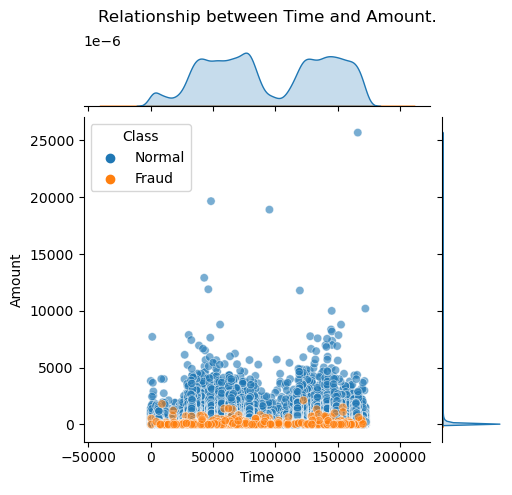

In [96]:
# data visualization about the relationship between 'Time' and 'Amount'
single_sca(df_obvious_feats, 'Time', 'Amount')

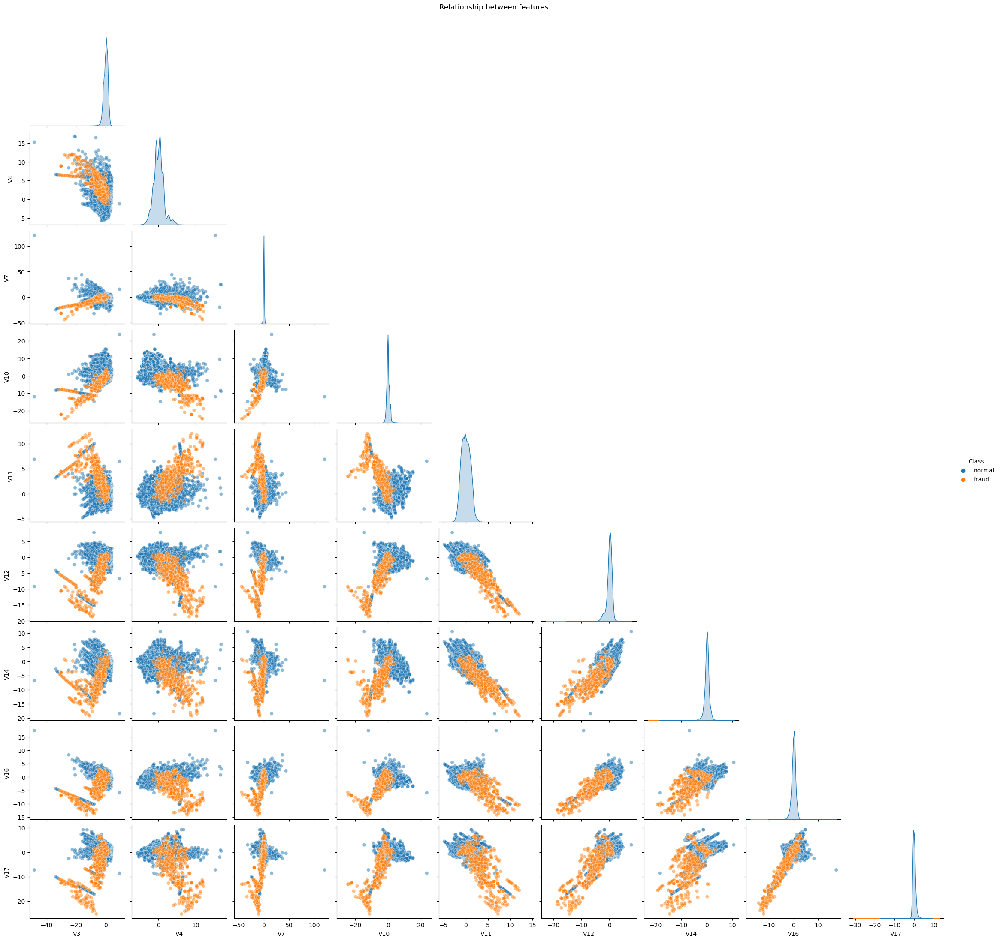

CPU times: total: 6min 45s
Wall time: 6min 20s


In [21]:
%%time
# data visualization about the relationship between each features that have strong correlation
pair_sca(df_hidden_feats, ['V3', 'V4', 'V7', 'V10', 'V11', 'V12', 'V14', 'V16', 'V17'])

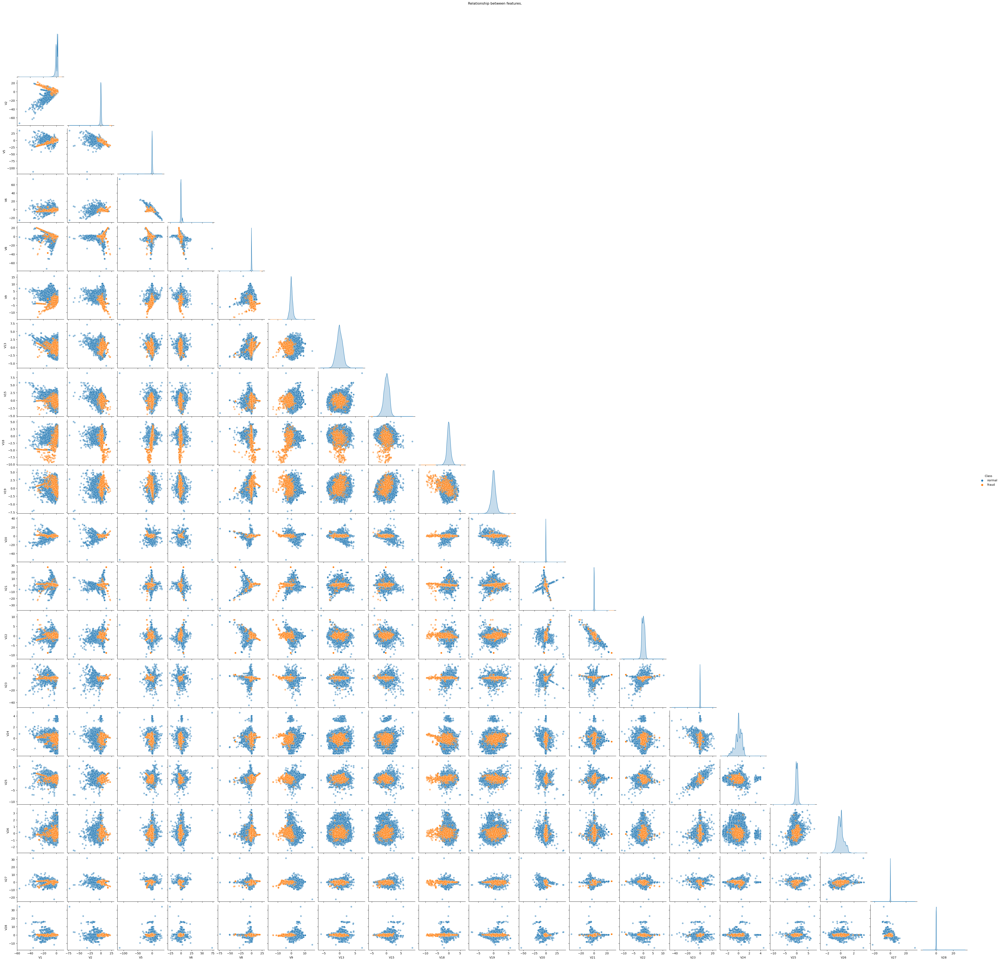

CPU times: total: 30min 6s
Wall time: 29min 14s


In [22]:
%%time
# data visualization about the relationship between each features that have weak correlation
pair_sca(df_hidden_feats, ['V1', 'V2', 'V5', 'V6', 'V8', 'V9', 'V13', 'V15', 'V18', 'V19',
                           'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28'])

In [5]:
# make a new dataset after correlation coeffcient analysis
# df_corr_feats used for futhre data visualization, data split, and data manipulation
df_corr_feats = keep_col(df_hidden_feats, columns=['V3', 'V4', 'V7', 'V10', 'V14', 'V17', 'Class'])

# save dataset for further testing
df_corr_feats.to_csv('project/981B/df_corr.csv', index=False)

In [9]:
df_corr_feats.head(4)

,V3,V4,V7,V10,V14,V17,Class
0,2.536347,1.378155,0.239599,0.090794,-0.311169,0.207971,0
1,0.166480,0.448154,-0.078803,-0.166974,-0.143772,-0.114805,0
2,1.773209,0.379780,0.791461,0.207643,-0.165946,1.109969,0
3,1.792993,-0.863291,0.237609,-0.054952,-0.287924,-0.684093,0


In [10]:
df_corr_feats.Class.value_counts()

0    284315
1       492
Name: Class, dtype: int64

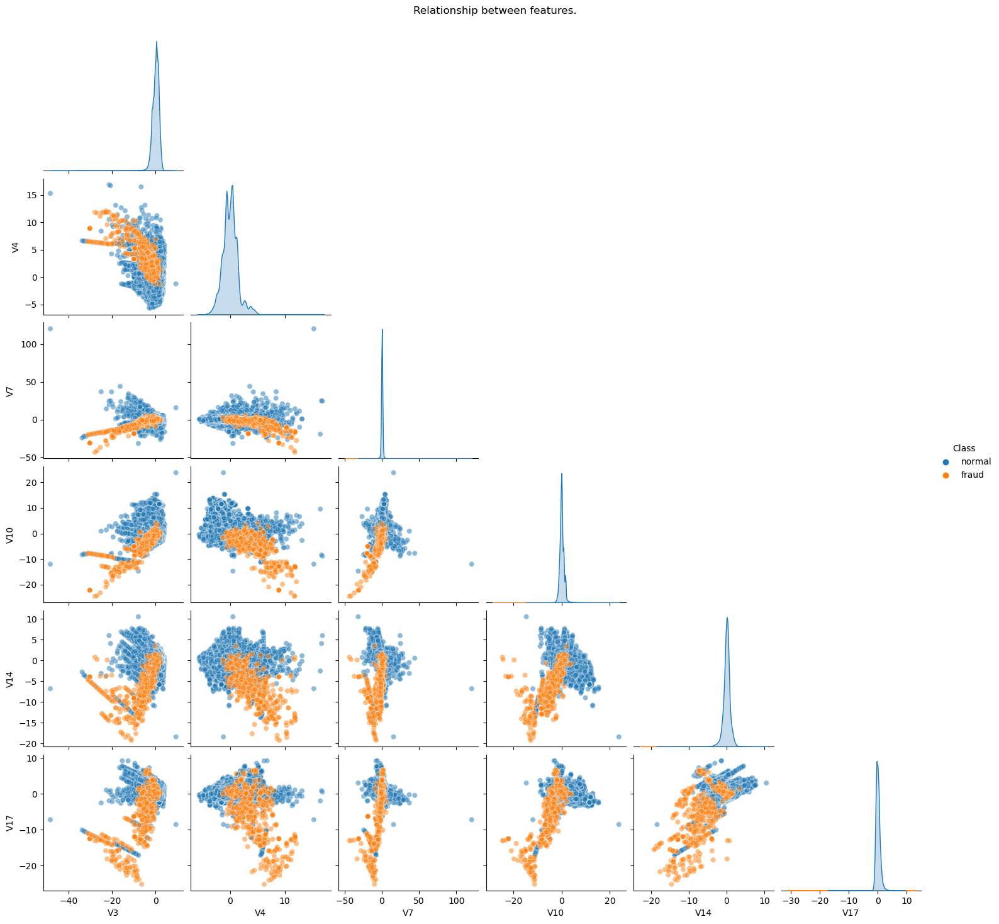

CPU times: total: 3min 3s
Wall time: 2min 46s


In [27]:
%%time
pair_sca(df_corr_feats)

## 2.3 Dataset preparation -- train test split
1. All ori datasets are used to fit autoencoder and test the result
2. All corr datasets will directly fix into extra tree model, no extra feature extraction since it already done by correlation and visualization analysis
3. **Three outcome** will be compared:
    1. **original** without any data process
    2. original dataset through **autoencoder and UMAP**
    3. original dataset  through **correlation and visualization analysis**

In [9]:
# customed train test split function
def data_split(dataset, columns='Class', sp_size=0.2):
     
    #columns should be a list or single str
    input = dataset.drop(columns, axis=1)
    target = dataset.Class
    X_train, X_test, y_train, y_test = train_test_split(input, target, test_size=sp_size,
                                                    random_state=1, stratify=target)
    
    return X_train, X_test, y_train, y_test

In [10]:
X_train_all, X_test_all, y_train_all, y_test_all = data_split(df_hidden_feats)
X_train_corr, X_test_corr, y_train_corr, y_test_corr = data_split(df_corr_feats)

### Check the split dataset

In [16]:
X_train_all.head(4)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28
105644,1.135011,-0.663898,0.703924,0.069871,-0.488154,1.312078,-0.897198,0.463148,-0.478801,0.396879,...,-2.246958,-0.677938,-0.331487,-0.069644,0.183987,-0.618678,0.089015,0.521419,0.086390,0.004782
139790,-1.786262,1.118886,1.347969,-0.379954,-1.240680,0.467667,0.081125,0.964933,0.042585,-1.275754,...,-0.241419,-0.099266,-0.047902,-0.182530,-0.162509,-0.405178,0.512595,0.299398,-0.042882,-0.059130
158758,-0.683414,0.679341,2.615556,2.362138,-0.012716,0.603826,0.574245,-0.679978,-0.811409,2.035115,...,1.656191,0.372610,-0.007167,0.463597,-0.243134,0.084557,-0.453177,2.687676,-1.084269,-0.511626
130845,1.183540,-0.493000,0.755202,-0.963160,-0.850295,0.145905,-0.794616,0.302199,1.656943,-0.939787,...,0.614310,-0.168134,0.039588,0.339340,-0.053125,-0.298049,0.423994,-0.652284,0.102582,0.017292


In [17]:
X_train_corr.head(4)

,V3,V4,V7,V10,V14,V17
105644,0.703924,0.069871,-0.897198,0.396879,-0.252977,1.648897
139790,1.347969,-0.379954,0.081125,-1.275754,-0.149358,-0.405073
158758,2.615556,2.362138,0.574245,2.035115,-0.859411,-0.035668
130845,0.755202,-0.963160,-0.794616,-0.939787,0.156943,-0.207755


In [18]:
X_train_all.shape, X_train_corr.shape

((199364, 28), (199364, 6))

In [19]:
y_train_all.shape, y_train_corr.shape

((199364,), (199364,))

In [20]:
y_train_all.value_counts(), y_test_all.value_counts()

(0    199020
 1       344
 Name: Class, dtype: int64,
 0    85295
 1      148
 Name: Class, dtype: int64)

In [21]:
y_train_corr.value_counts(), y_test_corr.value_counts()

(0    199020
 1       344
 Name: Class, dtype: int64,
 0    85295
 1      148
 Name: Class, dtype: int64)

## 2.4 Feature extraction -- UMAP and Autoencoder
In this section, we will use UMAP which is ...... to reduce the dimension of original dataset.  
From previous section, we know that 'Time' and 'Amount' features are trivial, so I decided to remove these two features at first.  
Based on correlation coefficient matrix, other features will be transformed to a **three dimension** representation by using UMAP.  
So maybe need 1, 2, 3 dimensions of representation of the original 28 features

### Dataset normalization
UMAP requires that dataset need to be normalized when each features are indipendent

In [6]:
# define a function to normalized the dataset
def nor_df(dataset):
    
    scaler = StandardScaler()
    df_nor = dataset.copy()

    #Columns need to be normalized
    col_nor = df_nor.columns.difference(['Class'])
    df_nor[col_nor] = scaler.fit_transform(df_nor[col_nor])
    
    return df_nor

In [7]:
# only 28 features dataset will be normalized since it will be fit into autoencoder
df_nor = nor_df(df_hidden_feats)

### Check the normalized dataset

In [26]:
df_nor.head(4)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
0,-0.694242,-0.044075,1.672773,0.973366,-0.245117,0.347068,0.193679,0.082637,0.331128,0.083386,...,0.326118,-0.024923,0.382854,-0.176911,0.110507,0.246585,-0.392170,0.330892,-0.063781,0
1,0.608496,0.161176,0.109797,0.316523,0.043483,-0.061820,-0.063700,0.071253,-0.232494,-0.153350,...,-0.089611,-0.307377,-0.880077,0.162201,-0.561131,0.320694,0.261069,-0.022256,0.044608,0
2,-0.693500,-0.811578,1.169468,0.268231,-0.364572,1.351454,0.639776,0.207373,-1.378675,0.190700,...,0.680975,0.337632,1.063358,1.456320,-1.138092,-0.628537,-0.288447,-0.137137,-0.181021,0
3,-0.493325,-0.112169,1.182516,-0.609727,-0.007469,0.936150,0.192071,0.316018,-1.262503,-0.050468,...,-0.269855,-0.147443,0.007267,-0.304777,-1.941027,1.241904,-0.460217,0.155396,0.186189,0


In [29]:
df_nor.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
count,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000
mean,-1.506872e-17,-9.580116e-18,-8.622104e-17,-5.189230e-18,3.832046e-17,9.979288e-18,1.237432e-17,-3.193372e-18,7.234983e-19,5.588401e-18,...,-1.247411e-18,-3.642440e-18,3.193372e-18,8.781773e-18,9.580116e-18,-5.029561e-17,5.887780e-18,2.444925e-18,-7.908585e-18,0.001727
std,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,...,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,0.041527
min,-2.879855e+01,-4.403529e+01,-3.187173e+01,-4.013919e+00,-8.240810e+01,-1.963606e+01,-3.520940e+01,-6.130252e+01,-1.222802e+01,-2.258191e+01,...,-7.069146e+01,-4.741907e+01,-1.506565e+01,-7.175446e+01,-4.683638e+00,-1.975033e+01,-5.401098e+00,-5.590660e+01,-4.674612e+01,0.000000
25%,-4.698918e-01,-3.624707e-01,-5.872142e-01,-5.993788e-01,-5.010686e-01,-5.766822e-01,-4.478860e-01,-1.746805e-01,-5.853631e-01,-4.917360e-01,...,-2.746334e-01,-3.109433e-01,-7.473476e-01,-2.591784e-01,-5.854676e-01,-6.084001e-01,-6.780717e-01,-1.755053e-01,-1.604440e-01,0.000000
50%,9.245351e-03,3.965683e-02,1.186124e-01,-1.401724e-02,-3.936682e-02,-2.058046e-01,3.241723e-02,1.871982e-02,-4.681169e-02,-8.533551e-02,...,-8.104705e-02,-4.009429e-02,9.345377e-03,-1.792420e-02,6.765678e-02,3.183240e-02,-1.081217e-01,3.325174e-03,3.406368e-02,0.000000
75%,6.716939e-01,4.867202e-01,6.774569e-01,5.250082e-01,4.433465e-01,2.991625e-01,4.611107e-01,2.740785e-01,5.435305e-01,4.168842e-01,...,1.725733e-01,2.537392e-01,7.283360e-01,2.364319e-01,7.257153e-01,6.728006e-01,4.996663e-01,2.255648e-01,2.371526e-01,0.000000
max,1.253351e+00,1.335775e+01,6.187993e+00,1.191874e+01,2.521413e+01,5.502015e+01,9.747824e+01,1.675153e+01,1.419494e+01,2.180758e+01,...,5.113464e+01,3.703471e+01,1.447304e+01,3.607668e+01,7.569684e+00,1.442532e+01,7.293975e+00,7.831940e+01,1.025434e+02,1.000000


In [27]:
df_nor.shape

(284807, 29)

In [28]:
df_nor.Class.value_counts()

0    284315
1       492
Name: Class, dtype: int64

### Train test split of the normalized original dataset

In [11]:
X_train_ae, X_test_ae, y_train_ae, y_test_ae = data_split(df_nor)

In [31]:
X_train_ae.head(4)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28
105644,0.579474,-0.402044,0.464253,0.049349,-0.353672,0.984845,-0.725248,0.387782,-0.435817,0.364495,...,-2.760258,-0.879385,-0.451296,-0.095967,0.294634,-1.021518,0.170763,1.081274,0.214031,0.014486
139790,-0.911967,0.677577,0.889014,-0.268355,-0.898884,0.351030,0.065577,0.807914,0.038762,-1.171655,...,-0.296569,-0.128762,-0.065214,-0.251522,-0.260240,-0.669001,0.983344,0.620867,-0.106240,-0.179138
158758,-0.348913,0.411396,1.725014,1.668335,-0.009213,0.453231,0.464190,-0.569328,-0.738565,1.869054,...,2.034535,0.483329,-0.009757,0.638827,-0.389352,0.139615,-0.869359,5.573476,-2.686282,-1.549993
130845,0.604250,-0.298552,0.498072,-0.680262,-0.616047,0.109516,-0.642326,0.253024,1.508190,-0.863102,...,0.754645,-0.218095,0.053896,0.467603,-0.085073,-0.492118,0.813376,-1.352652,0.254148,0.052386


In [32]:
y_train_ae.value_counts()

0    199020
1       344
Name: Class, dtype: int64

### Autoencuder building

In [12]:
# define an autoencoder function
def auto_encoder(dataset, node_l1, node_h):
    
    # encoder network
    input_layer = Input(shape = (dataset.shape[1], ))
    encoded = Dense(node_l1, activation= 'tanh', activity_regularizer=regularizers.l1(10e-5))(input_layer)
    
    #Hidden layer
    hidden_layer = Dense(node_h, activation='relu', activity_regularizer=regularizers.l1(10e-5))(encoded)

    # Decoder network
    decoded = Dense(node_l1, activation='tanh')(hidden_layer)
    output_layer = Dense(dataset.shape[1], activation='relu')(decoded)
    
    # build a seperate encoder part to get the hidden layer
    encoder = Model(input_layer, hidden_layer)
    
    # Building an autoencoder
    model = Model(input_layer, output_layer)
    
    # compile the autoencoder
    model.compile(optimizer='adadelta', loss='mse')
    
    return model, encoder

In [13]:
#build the autoencoder and encoder for features transformation
autoencoder, encoder = auto_encoder(X_train_ae, 28, 4)

# train the autoencoder
autoencoder.fit(X_train_ae, X_train_ae, batch_size=64, epochs=20,
                    shuffle=True, validation_split=0.2)

Epoch 1/20
2493/2493 [==============================] - 3s 909us/step - loss: 1.0464 - val_loss: 1.0180
Epoch 2/20
2493/2493 [==============================] - 2s 890us/step - loss: 1.0372 - val_loss: 1.0098
Epoch 3/20
2493/2493 [==============================] - 2s 829us/step - loss: 1.0298 - val_loss: 1.0032
Epoch 4/20
2493/2493 [==============================] - 2s 959us/step - loss: 1.0239 - val_loss: 0.9980
Epoch 5/20
2493/2493 [==============================] - 2s 863us/step - loss: 1.0191 - val_loss: 0.9938
Epoch 6/20
2493/2493 [==============================] - 2s 829us/step - loss: 1.0152 - val_loss: 0.9903
Epoch 7/20
2493/2493 [==============================] - 2s 839us/step - loss: 1.0119 - val_loss: 0.9873
Epoch 8/20
2493/2493 [==============================] - 2s 827us/step - loss: 1.0092 - val_loss: 0.9848
Epoch 9/20
2493/2493 [==============================] - 2s 841us/step - loss: 1.0068 - val_loss: 0.9826
Epoch 10/20
2493/2493 [==============================] - 2s 851u

In [14]:
# normal and fraud transactions are fit into autoencoder seperately
# label 'Class' is excluded since it is a unsupervised learning process
# combine both normal and fraud part that generated by autoencoder

# define a function to rebuild the dataset after autoencoder transformation
def df_rebuild(input, target, encoder, nodes):
    
    # make a list of column name
    col = []
    for i in range(nodes):
        col.append(f'N{i+1}')
    
    # fit data into encoder to get hidden layer trans_input
    trans_input = encoder.predict(input)
    # rebuild a dataset after autoencoder transformation
    df_ = pd.DataFrame(trans_input, columns=col)
    # put the label back into the new dataset
    df_['Class'] = target.reset_index(drop=True)
    
    return df_

**Should create a new dataset which after autoencoder transferred to compare the original and correlation one**

In [15]:
# make a new dataset for data visualization after autoencoder transformation
df_encoded = df_rebuild(X_train_ae, y_train_ae, encoder, 4)

# test dataset after encoder is only to review the result
# df_encoded = dfRebuild(X_test_ae, y_test_ae, encoder_nor,  4)

6231/6231 [==============================] - 3s 548us/step


In [16]:
# save dataframe for further testing
df_encoded.to_csv('project/981B/df_encoded.csv', index=False)

In [37]:
df_encoded.head(4)

,N1,N2,N3,N4,N5,N6,Class
0,0.000000,0.000000,0.152191,0.145078,0.000000,1.587070,0
1,0.108319,0.733623,0.672702,0.000000,0.072211,0.000000,0
2,0.000000,1.646036,0.243657,0.743082,0.000000,0.000000,0
3,0.000000,0.398251,0.689579,0.581961,0.000000,0.184861,0


In [38]:
df_encoded.shape

(199364, 7)

In [40]:
df_encoded.Class.value_counts()

0    199020
1       344
Name: Class, dtype: int64

### plot function for 2D and 3D

In [109]:
# UMAP 2D plot function (Seaborn)
# 10mins for 70% of the whole dataset
def umap_2d(dataset):
    
    # build UMAP
    model = UMAP(n_components=2, n_neighbors=20, min_dist=0.05, random_state=1)
    project = model.fit_transform(dataset.drop('Class', axis=1))
    
    # build a new dataframe which transformed by UMAP
    df_extracted = pd.DataFrame(project, columns=['A', 'B'])
    df_extracted['Class'] = dataset['Class']
    
    df_ = df_extracted.sort_values('Class').replace({'Class': {0: 'normal', 1: 'fraud'}})
    
    #Seaborn scatter plot
    g = sns.scatterplot(data=df_, x='A', y='B', hue='Class', alpha=0.5).get_figure()
    
    g.suptitle('Features extraction by UMAP (2D)', y=0.95)
    plt.show()   

In [58]:
# UMAP 3d plot function (plotly)
def umap_3d(dataset):
    
    model = UMAP(n_components=3, n_neighbors=50, min_dist=0.05, random_state=1)
    project = model.fit_transform(dataset.drop('Class', axis=1))
    
    # build a new dataframe which transformed by UMAP
    df_extracted = pd.DataFrame(project, columns=['A', 'B', 'C'])
    df_extracted['Class'] = dataset['Class']
    
    df_ = df_extracted.replace({'Class': {0: 'normal', 1: 'fraud'}})
    
    g = px.scatter_3d(df_, x='A', y='B', z='C', color=df_dv.Class)
    g.update_traces(marker_size=5, marker=dict(opacity=0.5))
    g.update_layout(title='Features extraction by UMAP (3D)')
    
    g.show()

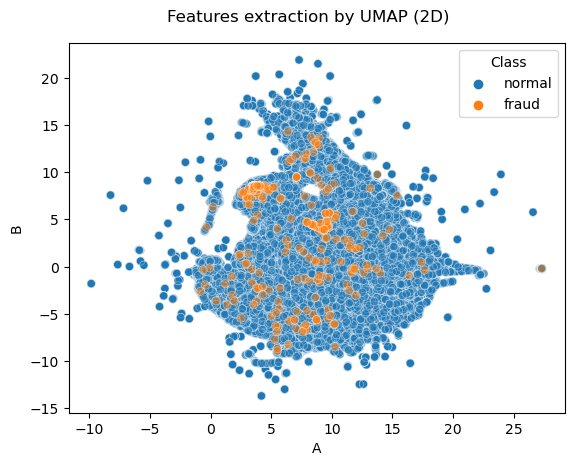

CPU times: total: 10min 27s
Wall time: 2min 44s


In [110]:
%%time
umap_2d(df_encoded)

In [63]:
df_nor_umap = pd.concat([X_train_ae, y_train_ae], axis=1)

In [66]:
df_nor_umap.Class.value_counts()

0    199020
1       344
Name: Class, dtype: int64

In [77]:
df_nor_umap.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
105644,0.579474,-0.402044,0.464253,0.049349,-0.353672,0.984845,-0.725248,0.387782,-0.435817,0.364495,...,-0.879385,-0.451296,-0.095967,0.294634,-1.021518,0.170763,1.081274,0.214031,0.014486,0
139790,-0.911967,0.677577,0.889014,-0.268355,-0.898884,0.351030,0.065577,0.807914,0.038762,-1.171655,...,-0.128762,-0.065214,-0.251522,-0.260240,-0.669001,0.983344,0.620867,-0.106240,-0.179138,0
158758,-0.348913,0.411396,1.725014,1.668335,-0.009213,0.453231,0.464190,-0.569328,-0.738565,1.869054,...,0.483329,-0.009757,0.638827,-0.389352,0.139615,-0.869359,5.573476,-2.686282,-1.549993,0
130845,0.604250,-0.298552,0.498072,-0.680262,-0.616047,0.109516,-0.642326,0.253024,1.508190,-0.863102,...,-0.218095,0.053896,0.467603,-0.085073,-0.492118,0.813376,-1.352652,0.254148,0.052386,0
88908,0.580787,0.063876,0.517330,0.886364,-0.435336,-0.270844,-0.130732,0.063710,0.255397,0.014499,...,-0.232043,-0.266420,-0.611360,0.074096,0.852389,0.859317,-1.150806,0.078836,0.055068,0


In [68]:
X_train_ae.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28
count,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,...,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000
mean,0.001630,-0.000382,0.001727,0.002785,-0.002101,0.001675,-0.000093,-0.001384,0.000606,-0.001253,...,-0.000693,-0.000761,0.000930,0.001924,0.000840,-0.000556,0.001028,-0.000755,-0.000177,0.001066
std,0.993018,0.986287,0.995594,0.999458,1.000245,1.001656,1.002160,1.015279,0.997405,0.992221,...,1.001244,0.989846,1.008738,0.999927,0.992477,1.000698,1.000748,1.000025,1.003638,1.004940
min,-28.798555,-44.035292,-31.871733,-4.013919,-82.408097,-19.636058,-35.209396,-61.302524,-12.228015,-22.581908,...,-8.861402,-70.691461,-47.419067,-15.065646,-58.716406,-4.664191,-16.683307,-5.255479,-55.906596,-46.746117
25%,-0.470061,-0.363344,-0.586395,-0.595587,-0.503185,-0.575157,-0.448532,-0.174369,-0.584239,-0.491407,...,-0.561390,-0.275139,-0.309632,-0.745089,-0.259594,-0.583799,-0.608556,-0.679688,-0.175077,-0.160279
50%,0.010168,0.038219,0.119336,-0.011830,-0.040398,-0.204188,0.031498,0.018850,-0.046255,-0.084269,...,0.004376,-0.081591,-0.039571,0.011184,-0.018361,0.067490,0.034721,-0.109453,0.003632,0.034427
75%,0.671542,0.483900,0.677431,0.527400,0.441763,0.300186,0.459277,0.274179,0.542498,0.417809,...,0.563472,0.172170,0.254362,0.729466,0.236557,0.724192,0.675204,0.499293,0.225254,0.237033
max,1.251799,13.357750,6.187993,11.805875,25.214135,55.020149,97.478239,16.751534,14.194945,21.807579,...,6.869414,51.134640,37.034714,14.473041,35.364272,7.569684,14.425318,7.293975,78.319397,102.543421


In [67]:
df_nor_umap.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
count,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,...,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000
mean,0.001630,-0.000382,0.001727,0.002785,-0.002101,0.001675,-0.000093,-0.001384,0.000606,-0.001253,...,-0.000761,0.000930,0.001924,0.000840,-0.000556,0.001028,-0.000755,-0.000177,0.001066,0.001725
std,0.993018,0.986287,0.995594,0.999458,1.000245,1.001656,1.002160,1.015279,0.997405,0.992221,...,0.989846,1.008738,0.999927,0.992477,1.000698,1.000748,1.000025,1.003638,1.004940,0.041503
min,-28.798555,-44.035292,-31.871733,-4.013919,-82.408097,-19.636058,-35.209396,-61.302524,-12.228015,-22.581908,...,-70.691461,-47.419067,-15.065646,-58.716406,-4.664191,-16.683307,-5.255479,-55.906596,-46.746117,0.000000
25%,-0.470061,-0.363344,-0.586395,-0.595587,-0.503185,-0.575157,-0.448532,-0.174369,-0.584239,-0.491407,...,-0.275139,-0.309632,-0.745089,-0.259594,-0.583799,-0.608556,-0.679688,-0.175077,-0.160279,0.000000
50%,0.010168,0.038219,0.119336,-0.011830,-0.040398,-0.204188,0.031498,0.018850,-0.046255,-0.084269,...,-0.081591,-0.039571,0.011184,-0.018361,0.067490,0.034721,-0.109453,0.003632,0.034427,0.000000
75%,0.671542,0.483900,0.677431,0.527400,0.441763,0.300186,0.459277,0.274179,0.542498,0.417809,...,0.172170,0.254362,0.729466,0.236557,0.724192,0.675204,0.499293,0.225254,0.237033,0.000000
max,1.251799,13.357750,6.187993,11.805875,25.214135,55.020149,97.478239,16.751534,14.194945,21.807579,...,51.134640,37.034714,14.473041,35.364272,7.569684,14.425318,7.293975,78.319397,102.543421,1.000000


In [ ]:
%%time
umap_3d(df_nor_umap)

In [59]:
%%time
umap_3d(df_encoded)

CPU times: total: 10min 20s
Wall time: 3min 37s


# 3. Dataset resampling analysis
1. Pandas undersampling 1:10 (fraud: normal)
2. Oversampling
2. Undersampling

In [ ]:
# weighted resampling function for data visualization by using pandas
# input is X_train set, target is y_train set
# fraud transactions account for 10% of total resampled dataset
def res_weighted(input, target):
    
    # concatenate input and target into a new dataframe
    df_ = pd.concat([input, target], axis=1)
    
    # split normal and fraud transactions
    normal = df_.query('Class==0')
    fraud = df_.query('Class==1')
    
    # concatenate resampled normal transactions with fraud transactions
    normal_res = normal.sample(n=(len(fraud) * 9), random_state=1)
    df_res = pd.concat([normal_res, fraud])
    
    return df_res

In [ ]:
# over and under resampling function for data visualization by using imblearn
# input is X_train set, target is y_train set
# method is either oversampling or undersampling
# normal and fraud transactions both account for 50% of total resampled dataset
def resample(input, target, method):
    
    # choose resampling method
    if method == 'oversample':
        model = SMOTE(random_state=1)
    elif method == 'undersample':
        model = RandomUnderSampler(random_state=1)
    else:
        raise ValueError("Method must be provided!")
    
    # resampling input and target and return a pandas dataframe
    X_res, y_res = model.fit_resample(input, target)
    X_res['Class'] = y_res
    
    return X_res

## 3.1 Weighted sampling

In [23]:
df_w = res_weighted(X_train_corr, y_train_corr)

In [27]:
# save dataframe for further testing
df_w.to_csv('project/981B/df_w.csv', index=False)

In [24]:
df_w.head(4)

,V3,V4,V7,V10,V14,V17,Class
106066,0.850033,1.576178,0.026632,-0.332990,-0.210748,-0.798826,0
102005,1.344329,-0.068517,0.769226,-0.551040,0.399853,-0.762851,0
278450,1.201170,-0.962314,0.001741,-0.737621,0.446691,-0.725272,0
120218,0.044063,0.325909,-0.097035,-0.097356,0.323196,-0.377366,0


In [26]:
df_w.Class.value_counts(), len(df_w)

(0    4428
 1     492
 Name: Class, dtype: int64,
 4920)

In [81]:
# old
df_w.Class.value_counts(), len(df_w)

(0    3096
 1     344
 Name: Class, dtype: int64,
 3440)

## 3.1 Oversampling


In [28]:
df_over = resample(df_corr, 'oversample')

In [35]:
# save dataframe for further testing
df_over.to_csv('project/981B/df_over.csv', index=False)

In [29]:
df_over.head(4)

,V3,V4,V7,V10,V14,V17,Class
0,2.536347,1.378155,0.239599,0.090794,-0.311169,0.207971,0
1,0.166480,0.448154,-0.078803,-0.166974,-0.143772,-0.114805,0
2,1.773209,0.379780,0.791461,0.207643,-0.165946,1.109969,0
3,1.792993,-0.863291,0.237609,-0.054952,-0.287924,-0.684093,0


In [34]:
df_over.Class.value_counts()

0    284315
1    284315
Name: Class, dtype: int64

In [53]:
df_over.head(4)

,V3,V4,V7,V10,V14,V17,Class
0,0.703924,0.069871,-0.897198,0.396879,-0.252977,1.648897,0
1,1.347969,-0.379954,0.081125,-1.275754,-0.149358,-0.405073,0
2,2.615556,2.362138,0.574245,2.035115,-0.859411,-0.035668,0
3,0.755202,-0.963160,-0.794616,-0.939787,0.156943,-0.207755,0


In [54]:
df_over.Class.value_counts()

0    199020
1    199020
Name: Class, dtype: int64

## 3.2 Undersampling

In [31]:
df_under = resample(df_corr, 'undersample')

In [37]:
# save dataframe for further testing
df_under.to_csv('project/981B/df_under.csv', index=False)

In [32]:
df_under.head(4)

,V3,V4,V7,V10,V14,V17,Class
0,0.850033,1.576178,0.026632,-0.332990,-0.210748,-0.798826,0
1,1.344329,-0.068517,0.769226,-0.551040,0.399853,-0.762851,0
2,1.201170,-0.962314,0.001741,-0.737621,0.446691,-0.725272,0
3,0.044063,0.325909,-0.097035,-0.097356,0.323196,-0.377366,0


In [36]:
df_under.Class.value_counts()

0    492
1    492
Name: Class, dtype: int64

In [56]:
df_under.head(4)

,V3,V4,V7,V10,V14,V17,Class
0,0.255861,-0.434487,0.812389,-0.336664,1.679634,0.429910,0
1,0.161128,0.900622,0.202008,-0.049639,-0.049381,-0.874723,0
2,-0.077530,0.511035,-0.037758,-0.235347,-0.027220,-0.221271,0
3,2.625375,1.214384,0.040367,-0.245746,1.755294,0.528193,0


In [57]:
df_under.Class.value_counts()

0    344
1    344
Name: Class, dtype: int64

## 3.3 Data visualization analysis after resampling

### Weighted sampling

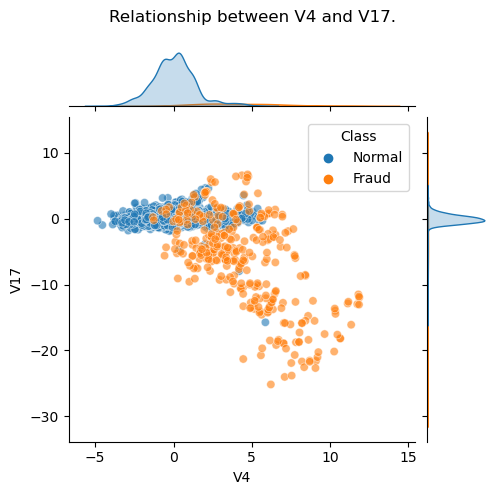

In [82]:
single_sca(df_w, 'V4', 'V17')

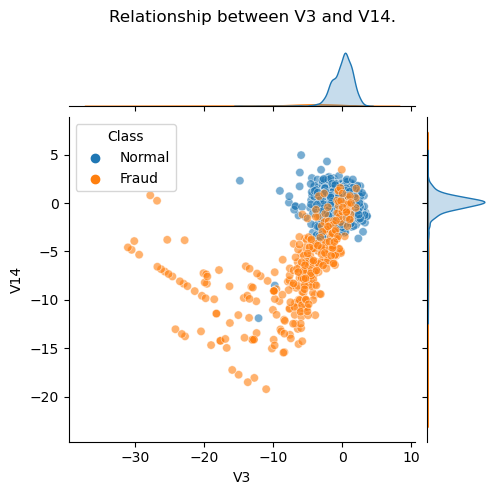

In [83]:
single_sca(df_w, 'V3', 'V14')

### Over sampling

In [ ]:
single_sca(df_over, 'V4', 'V17')

In [ ]:
single_sca(df_over, 'V3', 'V14')

### Under sampling

In [ ]:
single_sca(df_under, 'V4', 'V17')

In [ ]:
single_sca(df_under, 'V3', 'V14')

## 3.4 Building custom function for pipeline

In [ ]:
# this function is used for building a pipeline through cross validation
# fraud transactions account for 10% of total transactions
# df_corr will be fit into this function
def res_weighted_pl(input, target):
    
    # input and target should be numpy array that defined by FunctionSampler
    array_ = np.concatenate((input, target.reshape(-1, 1)), axis=1)
    
    # transfer numpy array into pandas dataframe with column name
    df_ = pd.DataFrame(array_, columns=['V3', 'V4', 'V7', 'V10', 'V14', 'V17', 'Class'])
    
    # split normal and fraud transactions
    normal = df_.query('Class==0')
    fraud = df_.query('Class==1')
    
    # concatenate resampled normal transactions with fraud transactions
    normal_res = normal.sample(n=(len(fraud) * 9), random_state=1)
    df_res = pd.concat([normal_res, fraud])
    
    # input target split
    X_res = df_res.drop('Class', axis=1)
    y_res = df_res.Class
    
    return X_res, y_res

# 4. Model selection and building

## 4.1 Model comparing and choosing by Pycaret

In [ ]:
# code in colab

## Making pipeline

In [ ]:
# making a function to create particular resampled pipeline
# model is the final classifier after hyperparameter tuning
def res_pl(method, model=None):
    
    # choose resampling method
    if method == 'weight':
        # custom sampler
        sampler = FunctionSampler(func=weighted_res)    
    elif method == 'under':
        sampler = RandomUnderSampler(random_state=1)
    elif method == 'over':
        sampler = SMOTE(random_state=1)
    else:
        raise ValueError("Method must be provided!")

    #  default classifier for further hyperparameter tuning
    clf = ExtraTreesClassifier(class_weight={0:0.1, 1:0.9}, random_state=1)

    if model is None:
        pipeline = Pipeline([('Resampler', sampler), ('Classifier', clf)])
    else:
        pipeline = Pipeline([('Resampler', sampler), ('Classifier', model)])

    return pipeline

In [ ]:
# pipelines for hyperparameter tuning
pl_w = res_pl('weight')
pl_under = res_pl('under')
pl_over = res_pl('over')

## 4.2 Hyper-parameter tuning

In [ ]:
# define parameters for further tuning
# for single classifier
param = {
    'n_estimators': [25, 50, 100],
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_features': ['sqrt', 'log2', None]
}

# for pipeline
param_res = {
    'Classifier__n_estimators': [25, 50, 100],
    'Classifier__criterion': ['gini', 'entropy', 'log_loss'],
    'Classifier__max_features': ['sqrt', 'log2', None]
}

In [ ]:
# build hyperparameter tuning function by using grid search
# par should be a dict, input and target are train set and labeled target
# search.best_params_
def hyper_tune(input, target, par, pl_grid=None, score='average_precision'):

    fold = StratifiedKFold(n_splits=5, shuffle=True, random_state=1)
    clf_grid = ExtraTreesClassifier(class_weight={0:0.1, 1:0.9}, random_state=1)
    
    if pl_grid is None:
        search = GridSearchCV(clf_grid, par, cv=fold, scoring=score)
    else:
        search = GridSearchCV(pl_grid, par, cv=fold, scoring=score)
    
    # fit the grid search
    search.fit(input, target)

    return search.best_estimator_

## Final Model

In [ ]:
#final models for predict and metrics assessment
final_model_w = hyper_tune(X_train_corr, y_train_corr, param_res, pl_w)
final_model_under = hyper_tune(X_train_corr, y_train_corr, param_res, pl_under)
final_model_over = hyper_tune(X_train_corr, y_train_corr, param_res, pl_over)
final_model_corr = hyper_tune(X_train_corr, y_train_corr, param)

In [ ]:
# resampled pipelines of final model for futher cross validation
pl_w = res_pl('weight', final_model_w)
pl_under = res_pl('under', final_model_under)
pl_over = res_pl('over', final_model_over)

## 4.3 Cross validation and oversampling the dataset

In [ ]:
# define a function to calculate cross validation score
def cv_score(input, target, pipeline=None, clf=None, score='average_precision'):

    sk_fold = StratifiedKFold(n_splits=5, shuffle=True, random_state=1)
    
    if pipeline is None:
        cv_score = cross_val_score(clf, input, target, cv=sk_fold, scoring=score)
    else:
        cv_score = cross_val_score(pipeline, input, target, cv=sk_fold, scoring=score)
    
    return cv_score

In [ ]:
# cross validation score for resampled method
score_w = cv_score(X_train_corr, y_train_corr, pl_w_final)
score_under = cv_score(X_train_corr, y_train_corr, pl_under_final)
score_over = cv_score(X_train_corr, y_train_corr, pl_over_final)
# cross validation score that applied to df_corr
score_corr = cv_score(X_train_corr, y_train_corr, model=final_model_corr)

In [ ]:
# check the volatility of cross validation score
def range(array):

    range = round(np.max(array) - np.min(array), 4)
    
    return range

In [ ]:
range(score_w), range(score_corr), range(score_under)

### Cross validation score visualizaiton

In [ ]:
# line plot of cross validation score to show volatility
def cv_plot(cvscore, metrics='recall'):
    
    plt.plot(cvscore)
    plt.title(f'Line plot of {metrics}', y=1.05)
    plt.xlabel('Number of trial')
    plt.ylabel(f'Test  {metrics}  estimation')
    plt.show()

In [ ]:
cv_plot(score_w)